In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn
import os

import sys

sys.path.append(os.path.abspath(os.path.join('..', '..', 'code', 'python')))
sys.path.append(os.path.abspath(os.path.join('..', '..', 'code', 'python', 'common')))
import common.plots as plots
import scale_setters as scale_setters
import ring_distribution

KeyboardInterrupt: 

In [2]:
def get_dir_names(path):
    directories = []
    for (dirpath, dirnames, filenames) in os.walk(path):
        directories.extend(dirnames)
        break
    return directories

def concat_observables(df, observables):
    data = []
    for obs in observables:
        data.append(df.loc[:, ['rad_aver', 'thickness', 'cut', obs, f'{obs}_err']])
        # data[-1] = data[-1].rename({obs: 'y', f'{obs}_err': 'err'}, axis=1)
        # data[-1]['observable'] = obs
    return pd.concat(data)

def read_data(path, observables, lattice, border):
    df = pd.DataFrame()
    velocity_dirs = get_dir_names(f'{path}/{lattice}/{border}')
    for velocity in velocity_dirs:
        beta_dirs = get_dir_names(f'{path}/{lattice}/{border}/{velocity}')
        for beta in beta_dirs:
            file_path = f'{path}/{lattice}/{border}/{velocity}/{beta}/observables_ring_result.csv'
            # print(file_path)
            if os.path.isfile(file_path):
                df_tmp = pd.read_csv(file_path, delimiter=' ')
                df_tmp = concat_observables(df_tmp, observables)
                df_tmp['velocity'] = float(velocity[:-1])
                df_tmp['beta'] = float(beta)
                df_tmp['border'] = border
                df_tmp['lattice'] = lattice[:-2]
                df = pd.concat([df, df_tmp])
    return df

In [3]:
beta_critical = {'nt4o': 4.088,
                 'nt5o': 4.225,
                 'nt6o': 4.350,
                 'nt7o': 4.470,
                 'nt4p': 4.073,
                 'nt5p': 4.202,
                 'nt6p': 4.318,
                 'nt7p': 4.417,
                 }

beta_critical_aver = {'nt4o': (4.088 + 4.073)/2,
                 'nt5o': (4.225+4.202)/2,
                 'nt6o': (4.350+4.318)/2,
                 'nt7o': (4.470+4.417)/2,
                 'nt4p': (4.088 + 4.073)/2,
                 'nt5p': (4.225+4.202)/2,
                 'nt6p': (4.350+4.318)/2,
                 'nt7p': (4.470+4.417)/2,
                 }

In [4]:
def plot_distribution_ring(df, border, observable):
    T = df.name
    plots.make_plot(df, 'rad_aver', observable, 'velocity', 'r', observable, f'distribution T={T:.4f}', f'../../images/eos_rotation_imaginary/5x30x121sq/{border}', f'distribution_ring_{observable}_T={T}', True, err=f'{observable}_err', color_palette='tab20')

In [ ]:
observable = 'E'
thickness = 5
cut = 5
path = '../../result/eos_rotation_imaginary'
border = 'OBCb_cV'
beta_crit = beta_critical['nt5o']
df_T = read_data(path, [observable], '5x30x121sq', border)
df_0 = read_data(path, [observable], '30x30x121sq', border)
print(df_T)
df_T['rad_aver'] = df_T['rad_aver'].apply(lambda x: round(x, 4))
df_0['rad_aver'] = df_0['rad_aver'].apply(lambda x: round(x, 4))
# df_T = df_T[df_T['beta'] == 4.4400]
# df_0 = df_0[df_0['beta'] == 4.4400]
# df_T = df_T[df_T['velocity'] < 0.7]
# df_0 = df_0[df_0['velocity'] < 0.7]
df_T = df_T[(df_T['thickness'] == thickness) & (df_T['cut'] == cut)]
df_0 = df_0[(df_0['thickness'] == thickness) & (df_0['cut'] == cut)]
df_tmp = pd.concat([df_0[['rad_aver', 'beta', 'velocity']], df_T[['rad_aver', 'beta', 'velocity']]])
df_tmp = df_tmp[df_tmp.duplicated(subset=['rad_aver', 'beta', 'velocity'], keep='first')]
df_0 = df_tmp.merge(df_0, how='left', on=['rad_aver', 'beta', 'velocity'])
df_T = df_tmp.merge(df_T, how='left', on=['rad_aver', 'beta', 'velocity'])
# print(df_T)
# print(df_0)
df_T[observable] = df_T[observable] - df_0[observable]
df_T[f'{observable}_err'] = np.sqrt(df_T[f'{observable}_err'] ** 2 + df_0[f'{observable}_err'] ** 2)
df_T = df_T[df_T['beta'] >= 3.85]
fm_to_GeV = 1/0.197327
scale_setter = scale_setters.ExtendedSymanzikScaleSetter()
df_T['a_GeV'] = scale_setter.get_spacing_in_fm(df_T['beta']) * fm_to_GeV
df_T['beta_crit'] = beta_crit
df_T['a_crit'] = scale_setter.get_spacing_in_fm(df_T['beta_crit']) * fm_to_GeV
df_T['T'] = df_T['a_crit'] / df_T['a_GeV']
df_T.set_index('T').groupby('T').apply(plot_distribution_ring, border, observable, include_groups=False)

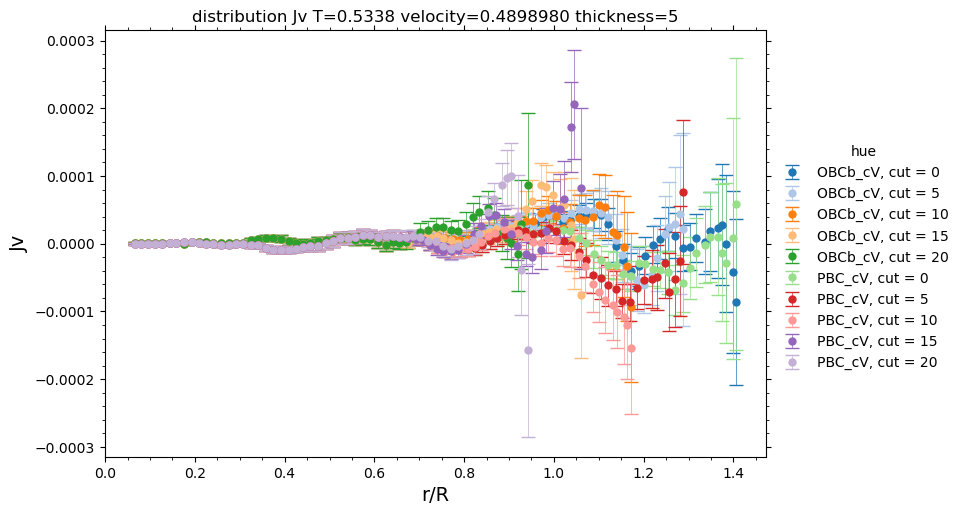

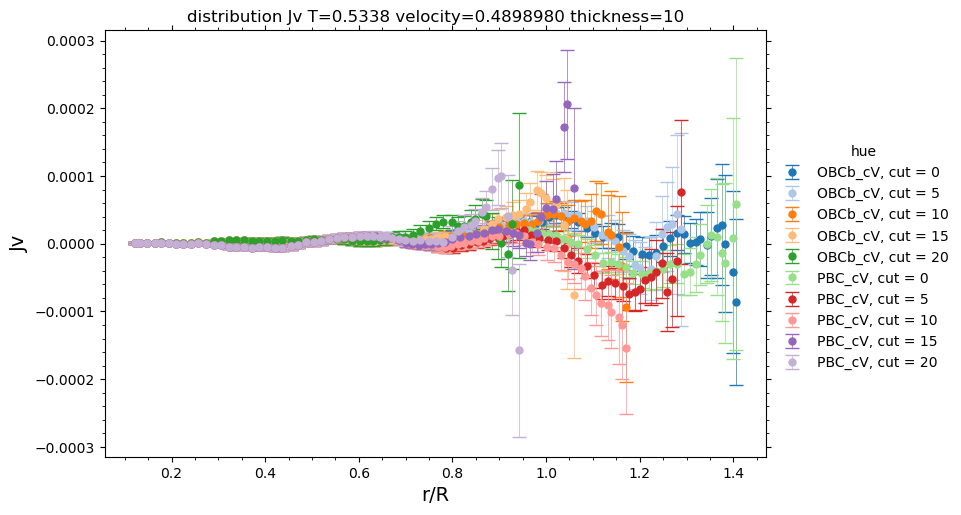

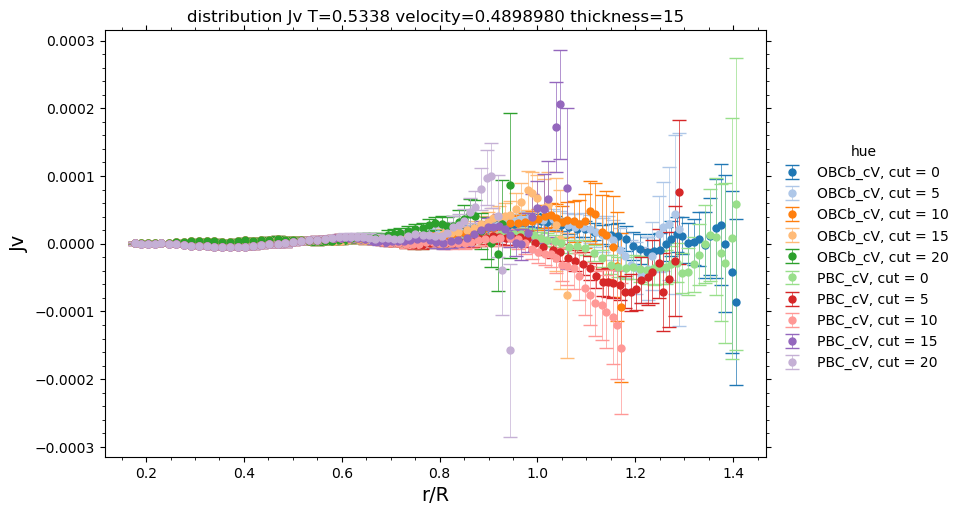

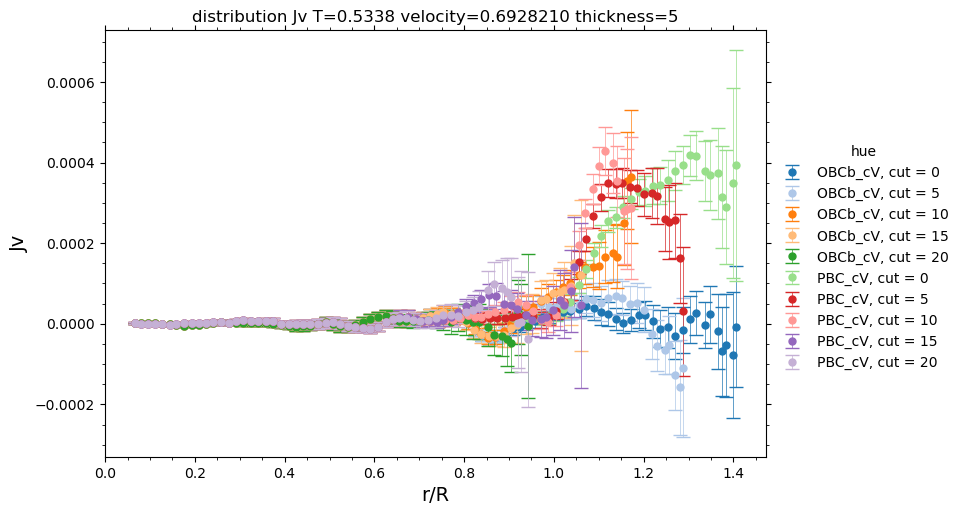

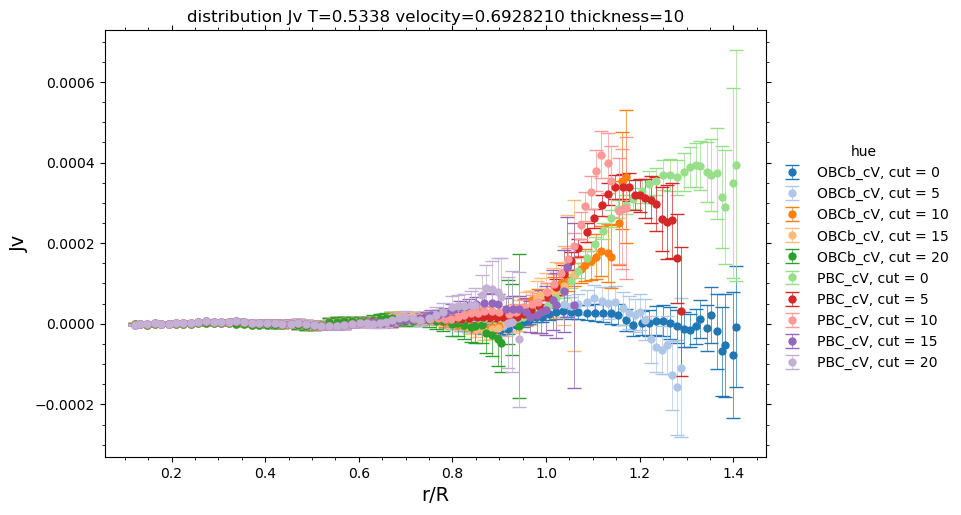

...

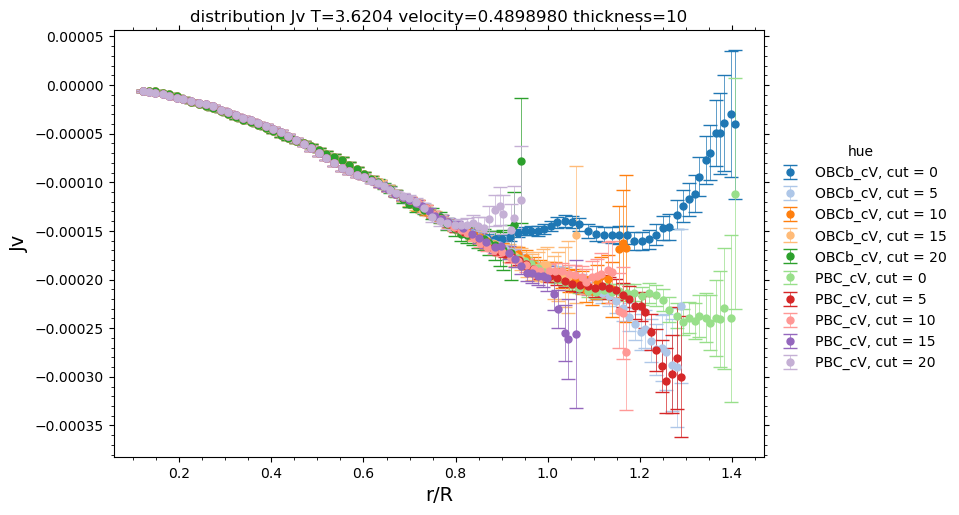

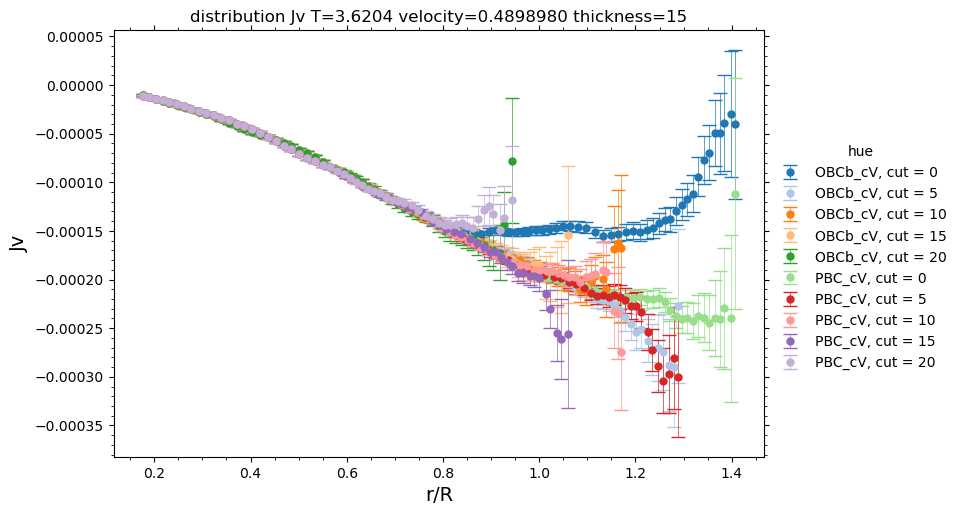

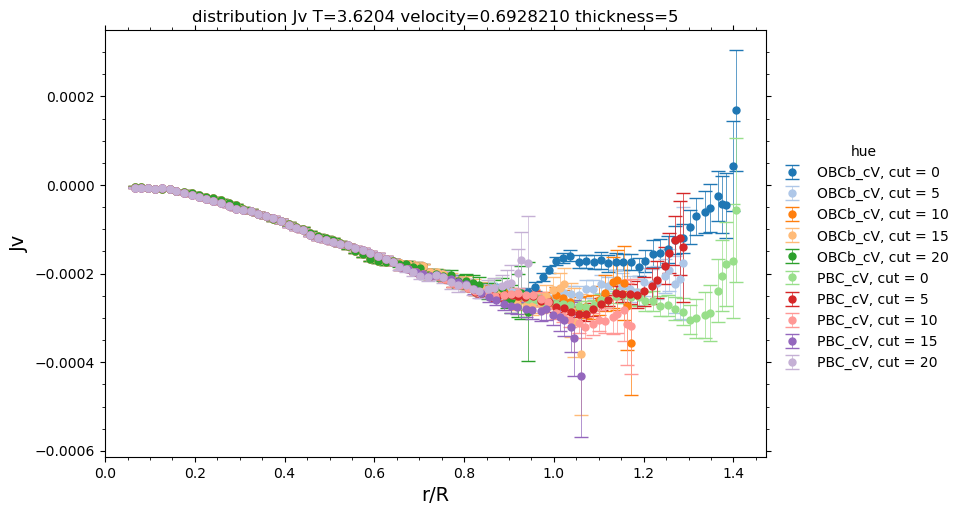

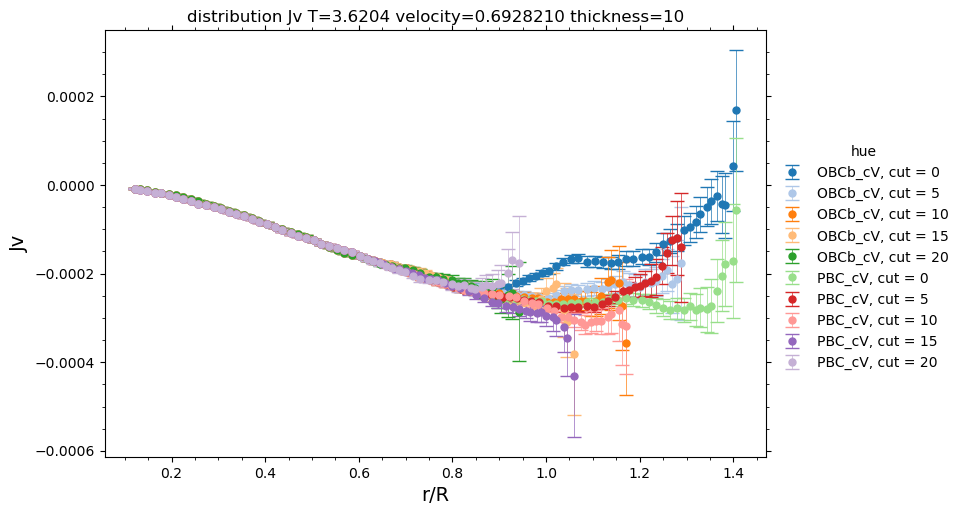

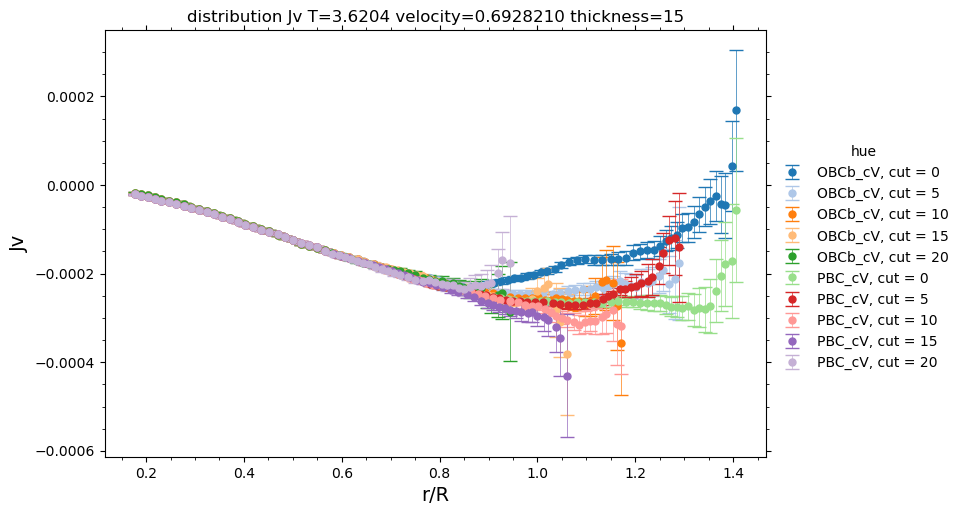

In [9]:
ring_distribution.distribution_boundary('Jv')

In [ ]:
ring_distribution.distribution_thickness('Jv')

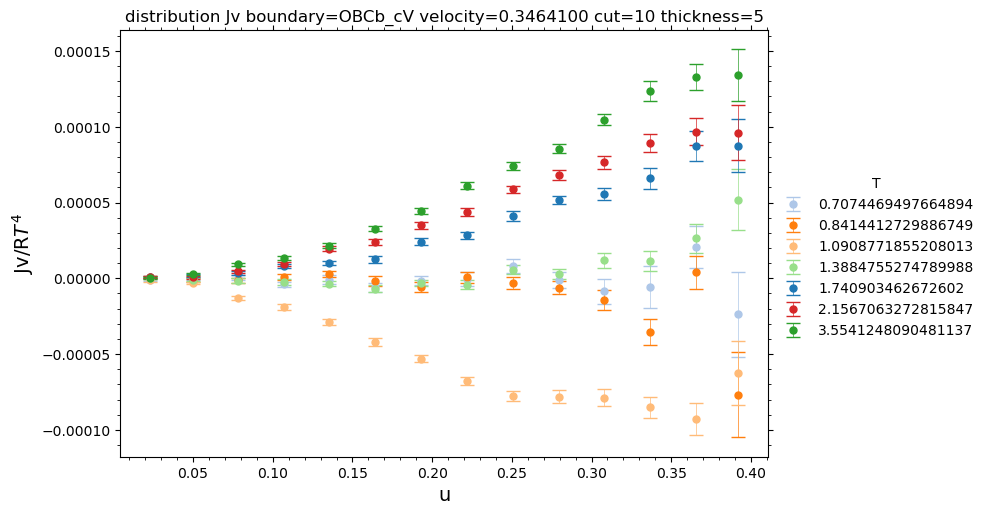

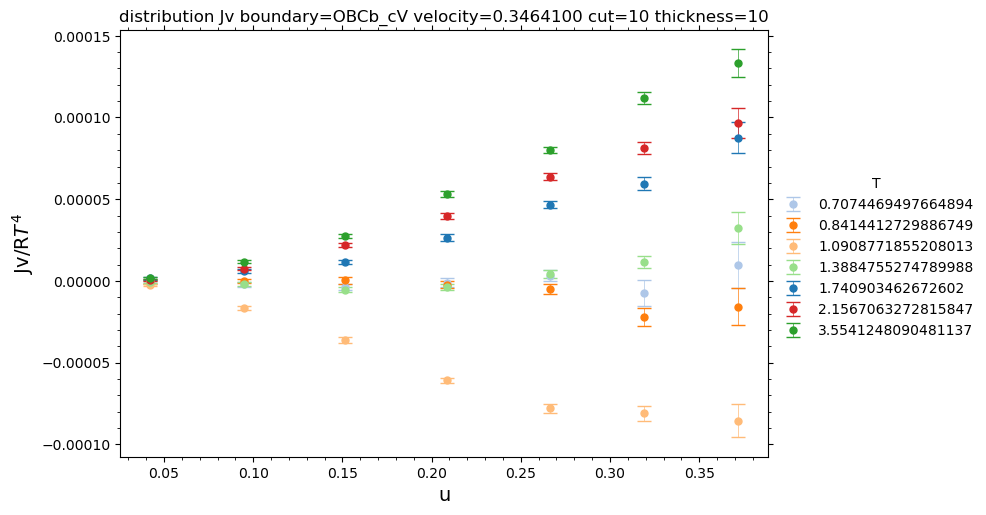

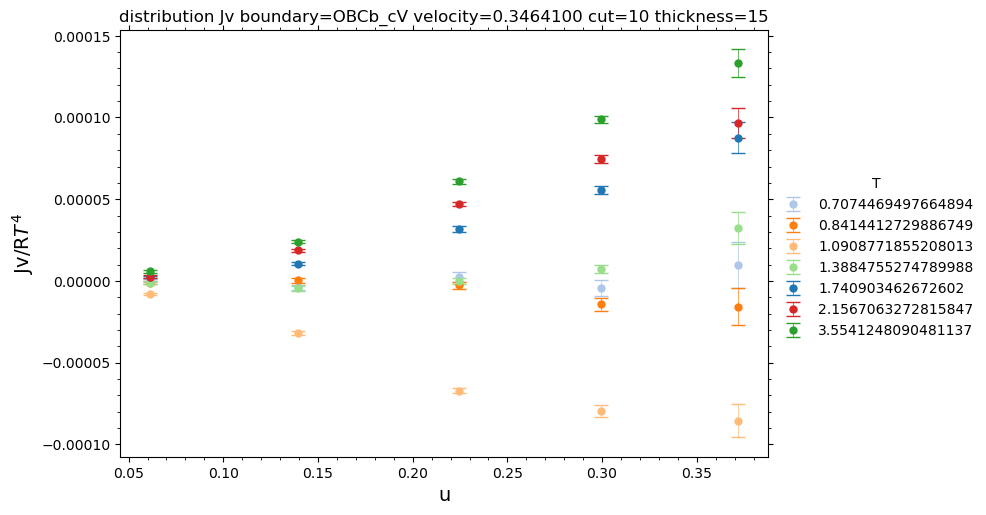

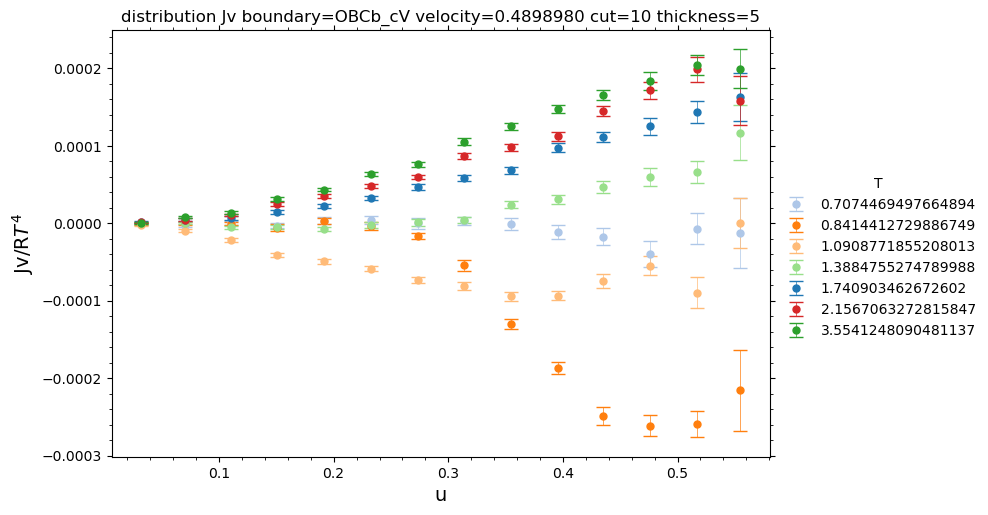

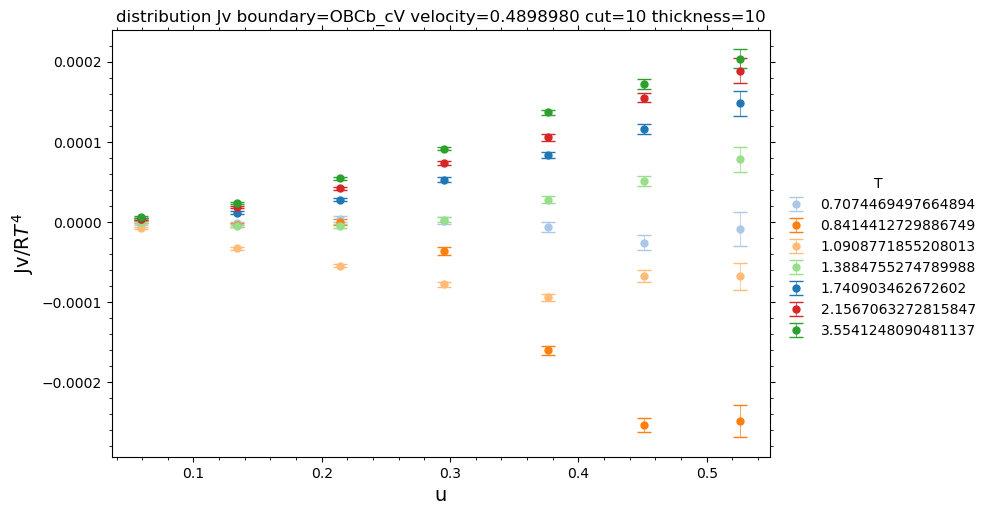

...

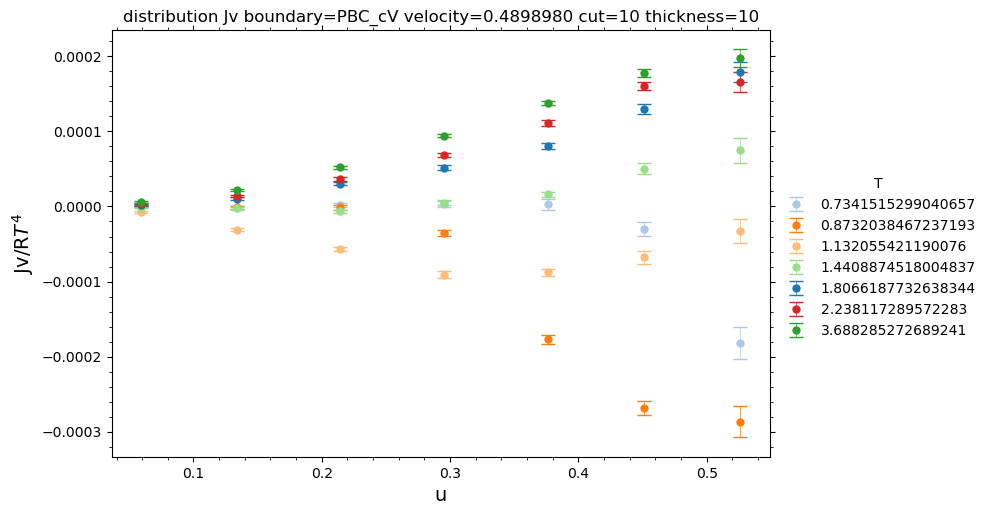

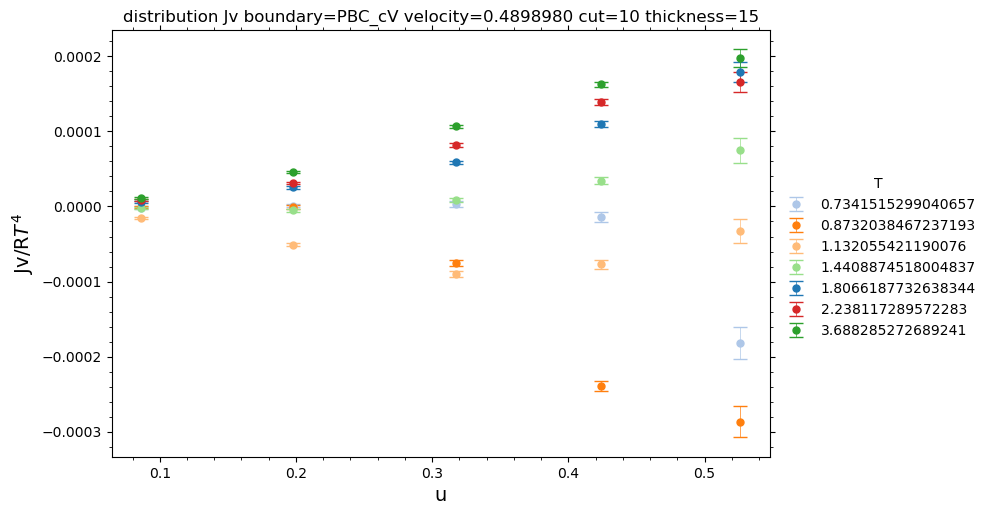

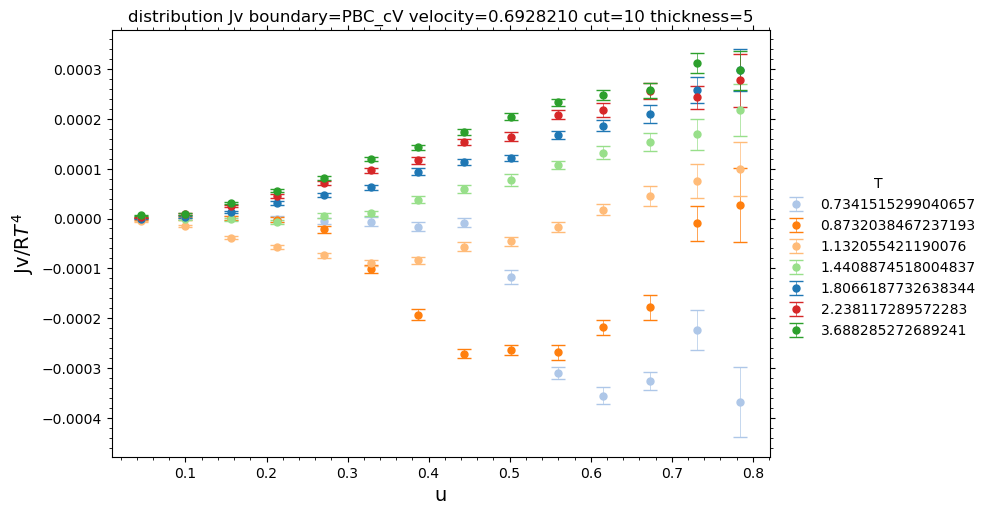

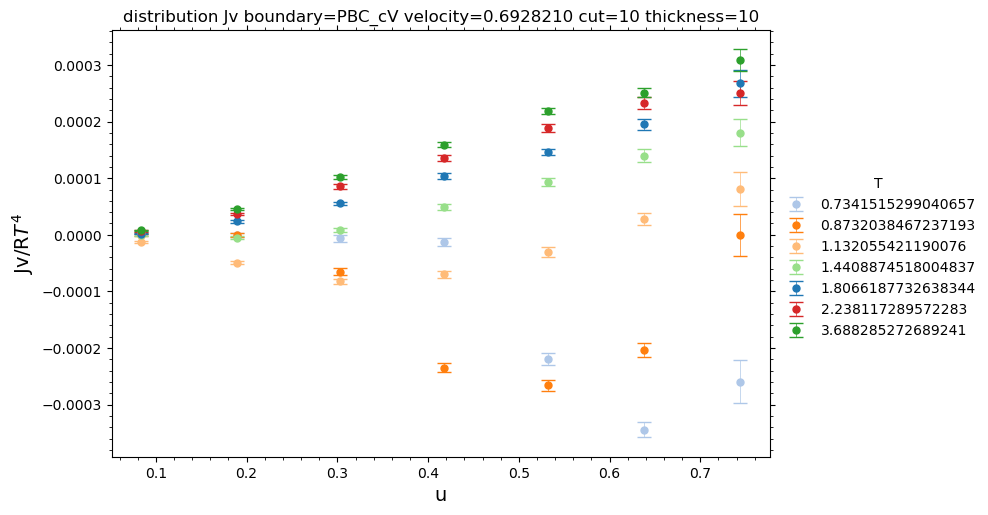

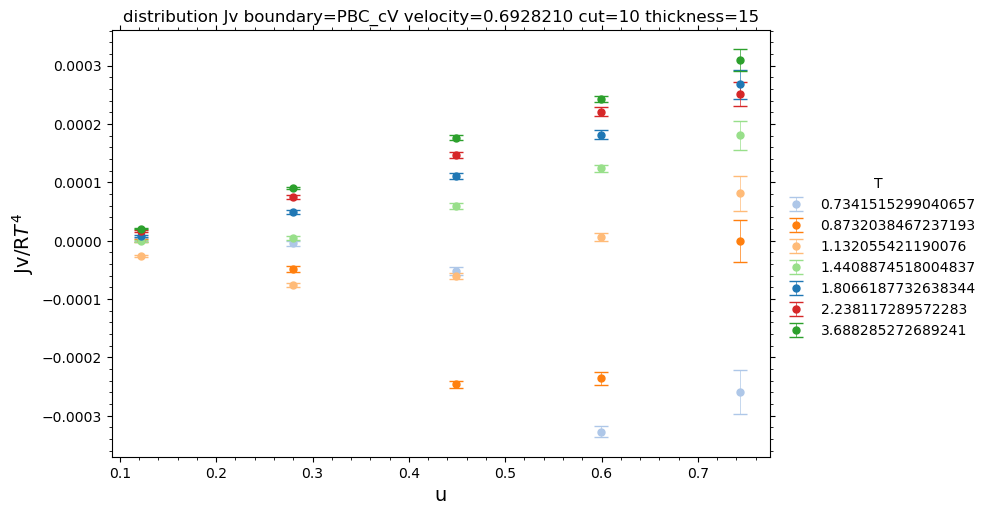

In [23]:
ring_distribution.distribution_temperature('Jv')